<a href="https://colab.research.google.com/github/Alan-Cheong/IEEE_QW_2020/blob/master/Bose-Einstein%20Condensate%20Animation%20(with%20Gravity).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [21]:
# Grok and some Deepseek code (%matplotlib notebook)
# NO EFFECTS OF GRAVITY
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
%matplotlib notebook

# Constants
N = 1000  # Number of particles
T_initial = 1.0  # Initial temperature in arbitrary units
T_final = 0.001  # Final temperature close to absolute zero
steps = 1000  # Number of simulation steps

# Particle positions (random at start)
particles = np.random.rand(N, 2)  # 2D positions

# Function to update particle positions based on cooling
def update(frame):
    # Cooling function: temperature decreases exponentially
    current_temp = T_initial * np.exp(-frame / (steps / 8))  # Exponential cooling

    # Update positions: particles move less as temperature decreases
    particles[:, 0] += np.random.normal(0, current_temp, N)
    particles[:, 1] += np.random.normal(0, current_temp, N)

    # Boundary conditions: wrap around if outside [0, 1]
    particles[:, 0] = np.mod(particles[:, 0], 1)
    particles[:, 1] = np.mod(particles[:, 1], 1)

    # Plotting
    plt.cla()
    plt.scatter(particles[:, 0], particles[:, 1], s=10, alpha=1, color='black')  # Increased size, full opacity, black for contrast
    #plt.scatter(particles[:, 0], particles[:, 1], s=1, alpha=0.5)
    plt.title(f'Bose-Einstein Condensate Cooling: T = {current_temp:.3f}')
    plt.xlim(0, 1)
    plt.ylim(0, 1)
    plt.gca().set_aspect('equal', adjustable='box')

# Set up the plot with a white background for better visibility
fig = plt.figure(figsize=(10, 10))
ax = plt.axes()
ax.set_facecolor('white')  # White background

# Animation
anim = FuncAnimation(fig, update, frames=np.arange(0, steps), interval=20, blit=False)
plt.show()

# Display the animation using HTML5 video
video = anim.to_html5_video()
html = HTML(video)
display(html)

# Keep the animation object alive until it's displayed
plt.show()

# Debugging: Print first few particle positions to verify they are within range
print("Sample particle positions:\n", particles[:5])

<IPython.core.display.Javascript object>

Sample particle positions:
 [[0.75063931 0.27712867]
 [0.084279   0.38832464]
 [0.34119534 0.13909701]
 [0.81168895 0.76300017]
 [0.8964913  0.4612449 ]]


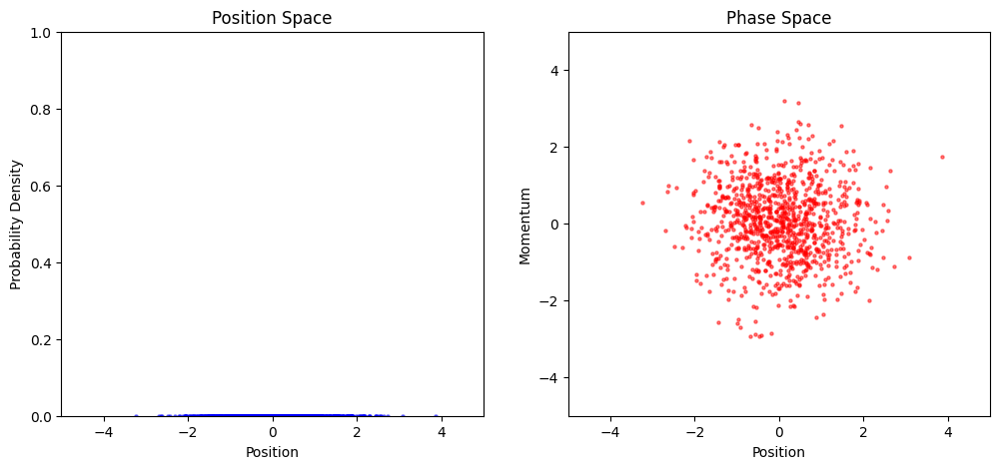

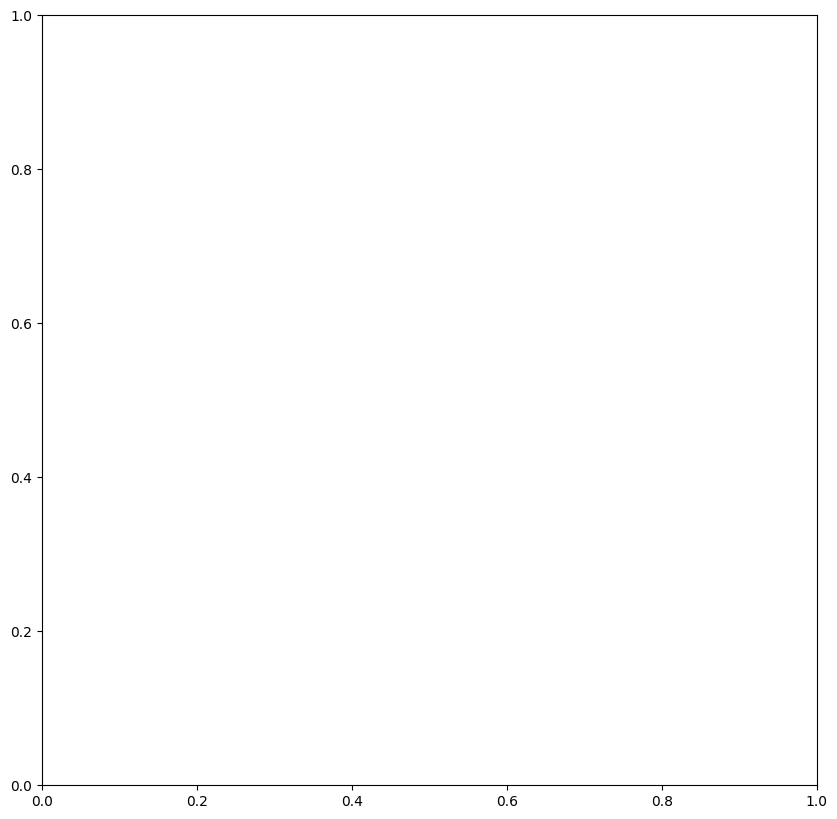

In [14]:
# Deepseek code
!pip install numpy matplotlib scipy

import numpy as np
import matplotlib
#matplotlib.use('TkAgg')  # Force backend (choose one that works for your system)
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation


import numpy as np

import matplotlib
#matplotlib.use('TkAgg')  # or 'Qt5Agg', 'WebAgg', etc.
from IPython.display import HTML
from scipy.constants import hbar, m_e

# Parameters
N = 1000  # Number of particles
T_initial = 1.0  # Initial "temperature" (arbitrary units)
cooling_rate = 0.99  # Cooling rate per frame
trap_frequency = 0.1  # Harmonic trap frequency

# Initialize particles with random positions and velocities
np.random.seed(42)
positions = np.random.normal(0, 1, N)
velocities = np.random.normal(0, T_initial, N)

# Set up the figure and axis
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
ax1.set_xlim(-5, 5)
ax1.set_ylim(0, 1)
ax1.set_title("Position Space")
ax1.set_xlabel("Position")
ax1.set_ylabel("Probability Density")

ax2.set_xlim(-5, 5)
ax2.set_ylim(-5, 5)
ax2.set_title("Phase Space")
ax2.set_xlabel("Position")
ax2.set_ylabel("Momentum")

# Scatter plots
scatter_pos = ax1.scatter(positions, np.zeros_like(positions), alpha=0.5, c='blue', s=5)
scatter_phase = ax2.scatter(positions, velocities, alpha=0.5, c='red', s=5)
temp_text = ax2.text(0.05, 0.95, '', transform=ax2.transAxes)

# Update function for animation
def update(frame):
    global velocities, positions, T_initial

    # Cooling process: reduce temperature and velocities
    T_initial *= cooling_rate
    velocities *= cooling_rate

    # Apply harmonic trap force (simulate confinement)
    positions += velocities * 0.1  # Small time step
    velocities += -trap_frequency**2 * positions * 0.1

    # Add quantum "condensation" effect (particles clump near center)
    condensation_strength = (1 - T_initial) * 0.1
    positions += condensation_strength * np.random.normal(0, 0.1, N)

    # Update plots
    scatter_pos.set_offsets(np.c_[positions, np.zeros_like(positions)])
    scatter_phase.set_offsets(np.c_[positions, velocities])
    temp_text.set_text(f'Temperature: {T_initial:.4f} (a.u.)')

    return scatter_pos, scatter_phase, temp_text

# Set up the plot with a white background for better visibility
fig = plt.figure(figsize=(10, 10))
ax = plt.axes()
ax.set_facecolor('white')  # White background

# Animation
anim = FuncAnimation(fig, update, frames=np.arange(0, steps), interval=20, blit=False)
plt.show()

# Create animation
ani = FuncAnimation(fig, update, frames=200, interval=50, blit=True)
plt.show()

# Display the animation using HTML5 video
video = anim.to_html5_video()
html = HTML(video)
display(html)

# Keep the animation object alive until it's displayed
plt.show()

In [18]:
!pip install numpy matplotlib scipy

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Parameters
N = 1000  # Number of particles
T_initial = 1.0  # Initial "temperature" (arbitrary units)
cooling_rate = 0.99  # Cooling rate per frame
trap_frequency = 0.1  # Harmonic trap frequency

# Initialize particles with random positions and velocities
np.random.seed(42)
positions = np.random.normal(0, 1, N)
velocities = np.random.normal(0, T_initial, N)

# Set up the figure and axis
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
ax1.set_xlim(-5, 5)
ax1.set_ylim(0, 1)
ax1.set_title("Position Space")
ax1.set_xlabel("Position")
ax1.set_ylabel("Probability Density")

ax2.set_xlim(-5, 5)
ax2.set_ylim(-5, 5)
ax2.set_title("Phase Space")
ax2.set_xlabel("Position")
ax2.set_ylabel("Momentum")

# Scatter plots
scatter_pos = ax1.scatter(positions, np.zeros_like(positions), alpha=0.5, c='blue', s=5)
scatter_phase = ax2.scatter(positions, velocities, alpha=0.5, c='red', s=5)
temp_text = ax2.text(0.05, 0.95, '', transform=ax2.transAxes)

# Update function for animation
def update(frame):
    global velocities, positions, T_initial

    # Cooling process: reduce temperature and velocities
    T_initial *= cooling_rate
    velocities *= cooling_rate

    # Apply harmonic trap force (simulate confinement)
    positions += velocities * 0.1  # Small time step
    velocities += -trap_frequency**2 * positions * 0.1

    # Add quantum "condensation" effect (particles clump near center)
    condensation_strength = (1 - T_initial) * 0.1
    positions += condensation_strength * np.random.normal(0, 0.1, N)

    # Update plots
    scatter_pos.set_offsets(np.c_[positions, np.zeros_like(positions)])
    scatter_phase.set_offsets(np.c_[positions, velocities])
    temp_text.set_text(f'Temperature: {T_initial:.4f} (a.u.)')

    return scatter_pos, scatter_phase, temp_text

# Create animation
ani = FuncAnimation(fig, update, frames=200, interval=50, blit=False)

# Display the animation
plt.show()

<IPython.core.display.Javascript object>

In [20]:
# Grok and Deepseek collab
# HAS THE EFFECTS OF GRAVITY
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
%matplotlib notebook

# Constants
N = 1000  # Number of particles
T_initial = 1.0  # Initial temperature in arbitrary units
T_final = 0.001  # Final temperature close to absolute zero
steps = 1000  # Number of simulation steps
g = 0.01  # Gravity, adjust for speed of falling

# Particle positions (random at start)
particles = np.random.rand(N, 2)  # 2D positions

# Function to update particle positions based on cooling and gravity
def update(frame):
    # Cooling function: temperature decreases exponentially
    current_temp = T_initial * np.exp(-frame / (steps / 8))  # Exponential cooling

    # Update positions: particles move less as temperature decreases but fall due to gravity
    dx = np.random.normal(0, current_temp, N)  # Movement in x-direction
    dy = np.random.normal(-g, current_temp, N)  # Movement in y-direction with gravity

    particles[:, 0] += dx
    particles[:, 1] += dy

    # Boundary conditions:
    # - x wraps around
    # - y does not wrap, particles stay at bottom
    particles[:, 0] = np.mod(particles[:, 0], 1)
    particles[:, 1] = np.maximum(particles[:, 1], 0)  # Particles can't go above y=0
    particles[:, 1] = np.minimum(particles[:, 1], 1)  # Particles stop at y=1 (bottom)

    # Plotting
    plt.cla()
    plt.scatter(particles[:, 0], particles[:, 1], s=10, alpha=1, color='black')
    plt.title(f'Bose-Einstein Condensate Cooling: T = {current_temp:.3f}')
    plt.xlim(0, 1)
    plt.ylim(0, 1)  # Y-axis flipped in matplotlib, 1 is bottom
    plt.gca().set_aspect('equal', adjustable='box')

# Set up the plot with a white background for better visibility
fig = plt.figure(figsize=(10, 10))
ax = plt.axes()
ax.set_facecolor('white')  # White background

# Animation
anim = FuncAnimation(fig, update, frames=np.arange(0, steps), interval=20, blit=False)

# Display the animation using HTML5 video
video = anim.to_html5_video()
html = HTML(video)
display(html)

# Keep the animation object alive until it's displayed
plt.show()

# Debugging: Print first few particle positions to verify they are within range

<IPython.core.display.Javascript object>